Original image shape: (1036, 690)
Data centered. Mean of each column subtracted.
Covariance matrix calculated.
Eigenvalues and eigenvectors computed.


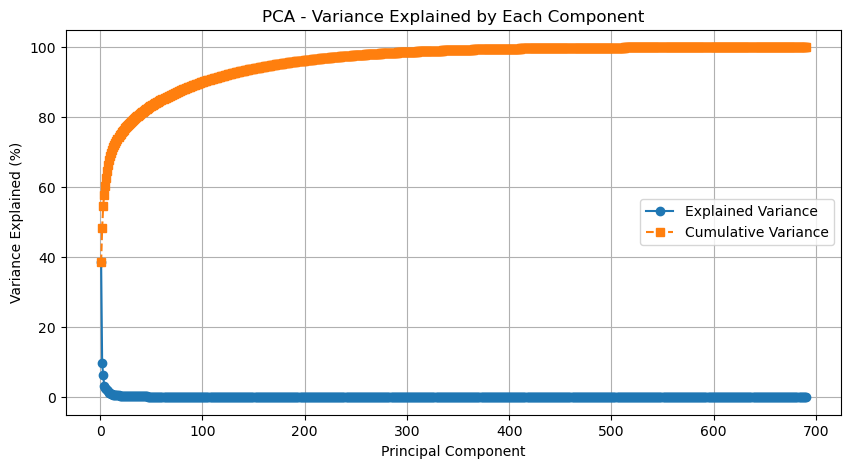

In [12]:
import numpy as np  # For numerical operations
import matplotlib.pyplot as plt  # For plotting
import cv2  # For image reading and processing
import os  # For file handling

# ---------------------------- Step-by-step PCA Implementation ----------------------------

def load_image_grayscale(path):
    """Loads an image in grayscale and converts to float32."""
    img = cv2.imread(path, cv2.IMREAD_GRAYSCALE)  # Load as grayscale
    if img is None:
        raise FileNotFoundError("Image not found at given path.")
    return img.astype(np.float32)  # Convert to float for PCA

# Exam relevant
def apply_pca(image):
    """Applies PCA manually to a 2D grayscale image."""
    print("Original image shape:", image.shape)

    # Step 1: Mean Centering (subtract mean of each column)
    mean_vec = np.mean(image, axis=0)
    centered_data = image - mean_vec
    print("Data centered. Mean of each column subtracted.")

    # Step 2: Covariance Matrix
    cov_matrix = np.cov(centered_data, rowvar=False)  # Columns as variables
    print("Covariance matrix calculated.")

    # Step 3: Eigen Decomposition
    eig_vals, eig_vecs = np.linalg.eigh(cov_matrix)  # Eigenvalues/vectors
    print("Eigenvalues and eigenvectors computed.")

    # Step 4: Sort eigenvalues and vectors
    sorted_idx = np.argsort(eig_vals)[::-1]
    eig_vals_sorted = eig_vals[sorted_idx]
    eig_vecs_sorted = eig_vecs[:, sorted_idx]

    # Step 5: Explained Variance
    explained_variance_ratio = eig_vals_sorted / np.sum(eig_vals_sorted)
    cumulative_variance = np.cumsum(explained_variance_ratio)

    return centered_data, mean_vec, eig_vecs_sorted, explained_variance_ratio, cumulative_variance

# ---------------------------- Visualization ----------------------------

def plot_explained_variance(explained_variance, cumulative_variance):
    """Plots explained variance and cumulative variance."""
    plt.figure(figsize=(10, 5))
    plt.plot(np.arange(1, len(explained_variance)+1), explained_variance * 100, 'o-', label='Explained Variance')
    plt.plot(np.arange(1, len(cumulative_variance)+1), cumulative_variance * 100, 's--', label='Cumulative Variance')
    plt.xlabel('Principal Component')
    plt.ylabel('Variance Explained (%)')
    plt.title('PCA - Variance Explained by Each Component')
    plt.legend()
    plt.grid(True)
    plt.show()

def reconstruct_and_plot(centered_data, mean_vec, eig_vecs_sorted, explained_variance_ratio, cumulative_variance):
    """Reconstructs and plots images using increasing number of PCs until full PCA rank is used."""
    h, w = centered_data.shape
    total_components = eig_vecs_sorted.shape[1]

    # Determine how many plots we can show per row
    columns = 5
    rows = (total_components + columns) // columns

    fig, axes = plt.subplots(rows, columns, figsize=(columns * 3, rows * 3))
    axes = axes.flatten()

    for k in range(total_components):
        projection_matrix = eig_vecs_sorted[:, :k+1]
        projected = np.dot(centered_data, projection_matrix)
        reconstructed = np.dot(projected, projection_matrix.T) + mean_vec
        variance = np.sum(explained_variance_ratio[:k+1])

        axes[k].imshow(np.clip(reconstructed, 0, 255), cmap='gray')
        axes[k].set_title(f"PCs: {k+1}\nVar: {variance*100:.2f}%")
        axes[k].axis('off')

    # Hide unused subplots
    for i in range(total_components, len(axes)):
        axes[i].axis('off')

    plt.tight_layout()
    plt.show()

# ---------------------------- Example Execution ----------------------------

# Replace this path with your image path from root folder
image_path = "/Users/h4/desktop/IMG_1176-2.jpg"

# Load and run PCA
image = load_image_grayscale(image_path)
centered_data, mean_vec, eig_vecs_sorted, explained, cumulative = apply_pca(image)

# Visualize variance
plot_explained_variance(explained, cumulative)

# Reconstruct using all available PCs
reconstruct_and_plot(centered_data, mean_vec, eig_vecs_sorted, explained, cumulative)
